In [26]:
import glob
import _init_paths
from fast_rcnn.config import cfg
from fast_rcnn.test import im_detect_hierarchy
from fast_rcnn.nms_wrapper import nms
from utils.timer import Timer
import matplotlib.pyplot as plt
import numpy as np
import scipy.io as sio
import caffe, os, sys, cv2
import argparse
from fast_rcnn.config import cfg, cfg_from_file, cfg_from_list
from datasets.config import CLASS_SETS

def _get_ann_file():
        prefix = 'image_info' 
        return os.path.join("/root/data/coco/", 'annotations',
                        prefix + '_' + "test2014" + '.json')

   

In [74]:
!cd ~/data/demo/
!mkdir special

In [76]:
!cd special/
!wget https://lh3.googleusercontent.com/-AwQ-gJ_8_TQ/WfKQxoJRuGI/AAAAAAAAAfU/ugm650-6f6EFLYQSceSO0IJTN9Sta7f0ACL0BGAYYCw/h769/2017-10-26.jpg

--2017-10-27 02:04:05--  https://lh3.googleusercontent.com/-AwQ-gJ_8_TQ/WfKQxoJRuGI/AAAAAAAAAfU/ugm650-6f6EFLYQSceSO0IJTN9Sta7f0ACL0BGAYYCw/h769/2017-10-26.jpg
Resolving lh3.googleusercontent.com (lh3.googleusercontent.com)... 216.58.200.33, 2404:6800:4008:800::2001
Connecting to lh3.googleusercontent.com (lh3.googleusercontent.com)|216.58.200.33|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 666792 (651K) [image/jpeg]
Saving to: '2017-10-26.jpg'

100%[======================================>] 666,792     --.-K/s   in 0.08s   

2017-10-27 02:04:05 (7.58 MB/s) - '2017-10-26.jpg' saved [666792/666792]



In [77]:
!wget https://lh3.googleusercontent.com/-wCBB3dzYc-M/WfKR9Xi4M0I/AAAAAAAAAfg/lxdbpbRZrLgVL-Cd_ACsbrgVL9uZRtrGACL0BGAYYCw/h769/2017-10-26.jpg

--2017-10-27 02:04:18--  https://lh3.googleusercontent.com/-wCBB3dzYc-M/WfKR9Xi4M0I/AAAAAAAAAfg/lxdbpbRZrLgVL-Cd_ACsbrgVL9uZRtrGACL0BGAYYCw/h769/2017-10-26.jpg
Resolving lh3.googleusercontent.com (lh3.googleusercontent.com)... 172.217.24.1, 2404:6800:4008:800::2001
Connecting to lh3.googleusercontent.com (lh3.googleusercontent.com)|172.217.24.1|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 661846 (646K) [image/jpeg]
Saving to: '2017-10-26.jpg.1'

100%[======================================>] 661,846     --.-K/s   in 0.09s   

2017-10-27 02:04:18 (6.77 MB/s) - '2017-10-26.jpg.1' saved [661846/661846]



In [79]:
pwd!

u'/root/pva-faster-rcnn/tools'

In [27]:
CLASSES_main = CLASS_SETS["coco"]
CLASSES_sub = CLASS_SETS['vehicle-types']



Loaded network ../models/hierarchy/v7/v7_iter_40000.caffemodel
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-van/images/set00/V000/set00_V000_472.jpg
(720, 1280, 3)
Detection took 0.158s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-van/images/set00/V000/set00_V000_1.jpg
(720, 1280, 3)
Detection took 0.076s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-van/images/set00/V000/set00_V000_300.jpg
(720, 1280, 3)
Detection took 0.076s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-van/images/set00/V000/set00_V000_201.jpg
(720, 1280, 3)
Detection took 0.075s for 191 object proposals
(191, 324)
(191, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-van/images/set00/V000/set00_V000_104.jpg
(720, 1280, 3)
Detection took 0.070s for 186 

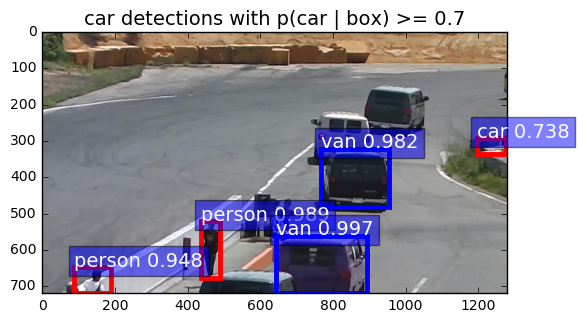

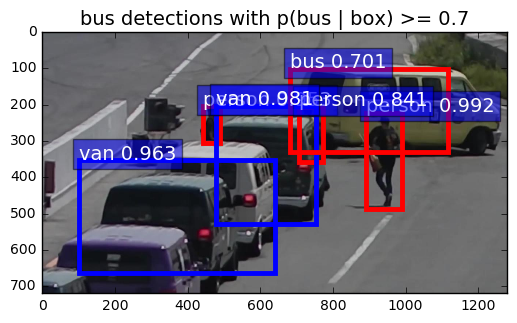

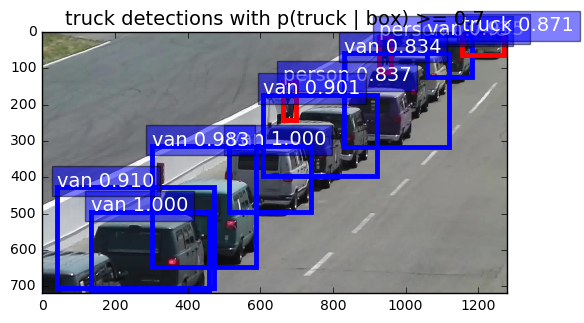

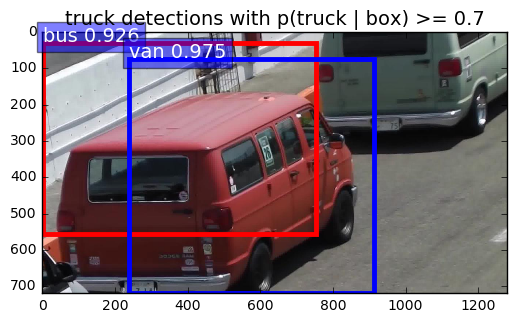

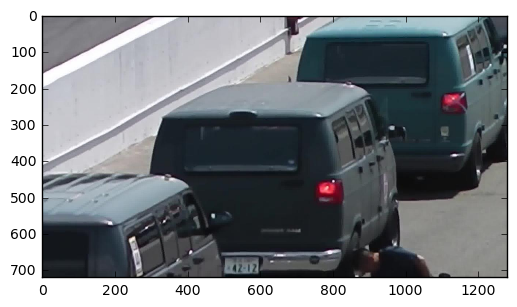

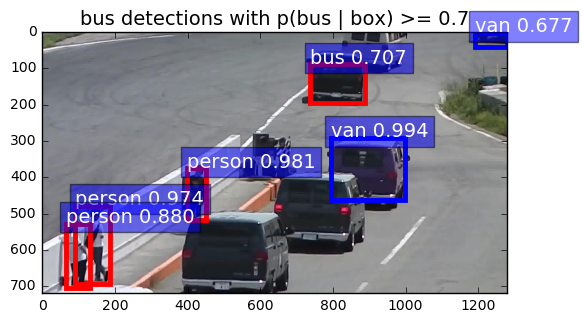

In [68]:
def get_sub_info(sub_scores, keeps, i):
    sub_ind = np.argmax(sub_scores[keeps][i])
    sub_score = sub_scores[keeps][i][sub_ind]
    sub_cls = CLASSES_sub[sub_ind]
    return sub_cls, sub_score, sub_ind

def vis_detections(im, class_names, dets_list, keeps_list, sub_scores, thresh=0.7):
    """Draw detected bounding boxes."""
    im = im[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(im, aspect='equal')
    
    for class_name, dets, keeps in zip(class_names, dets_list, keeps_list):

        inds = np.where(dets[:, -1] >= thresh)[0]
        if len(inds) == 0:
            continue


        for i in inds:
            bbox = dets[i, :4]
            score = dets[i, -1]
            sub_cls, sub_score, sub_ind = get_sub_info(sub_scores, keeps, i)
            #if sub_ind not in [1,2,3]:
                #continue
            edgecolor = "red"
            text = class_name
            confidence = score
            if (class_name == "car" or class_name == "truck") and sub_ind in [1,2,3]:
                text = sub_cls
                confidence = sub_score
                edgecolor = "blue"
                
            ax.add_patch(
                plt.Rectangle((bbox[0], bbox[1]),
                              bbox[2] - bbox[0],
                              bbox[3] - bbox[1], fill=False,
                              edgecolor=edgecolor, linewidth=3.5)
                )
            ax.text(bbox[0], bbox[1] - 2,
                    '{:s} {:.3f}'.format(text, confidence),
                    bbox=dict(facecolor='blue', alpha=0.5),
                    fontsize=14, color='white')

        ax.set_title(('{} detections with '
                      'p({} | box) >= {:.1f}').format(class_name, class_name,
                                                      thresh),
                      fontsize=14)
    #plt.axis('off')
    #plt.tight_layout()
    #plt.draw()

def demo(net, im_file):
    """Detect object classes in an image using pre-computed object proposals."""

    # Load the demo image
   
    im = cv2.imread(im_file)
    print(im.shape)
    #int("Hallo")
    

    # Detect all object classes and regress object bounds
    timer = Timer()
    timer.tic()
    _t = {'im_preproc': Timer(), 'im_net' : Timer(), 'im_postproc': Timer(), 'misc' : Timer()}
    scores, sub_scores,boxes = im_detect_hierarchy(net, im, _t)
    timer.toc()
    print ('Detection took {:.3f}s for '
           '{:d} object proposals').format(timer.total_time, boxes.shape[0])

    # Visualize detections for each class
    CONF_THRESH = 0.7
    NMS_THRESH = 0.3
    
    cls_list = []
    dets_list = []
    sub_cls_list = []
    keep_list = []
    print(boxes.shape)
    print(scores.shape)
    for cls_ind, cls in enumerate(CLASSES_main[1:]):
        cls_ind += 1 # because we skipped background
        cls_boxes = boxes[:, 4*cls_ind:4*(cls_ind + 1)]
        cls_scores = scores[:, cls_ind]
        dets = np.hstack((cls_boxes,
                          cls_scores[:, np.newaxis])).astype(np.float32)
        keep = nms(dets, NMS_THRESH)
        dets = dets[keep, :]    
        
        keep_list.append(keep)
        
        cls_list.append(cls)
        dets_list.append(dets)
        
        
        
        
    vis_detections(im, cls_list, dets_list,keep_list, sub_scores , thresh=CONF_THRESH)



if __name__ == '__main__':
    #cfg.TEST.HAS_RPN = True
   

    prototxt = "../models/pvanet/lite/hierachy/v1_test.prototxt"
    caffemodel = "../models/hierarchy/v7/v7_iter_40000.caffemodel"
    cfg_from_file("../models/pvanet/cfgs/submit_1019.yml")
    caffe.set_mode_gpu()
    caffe.set_device(0)
    cfg.GPU_ID = 0
    net = caffe.Net(prototxt, caffemodel, caffe.TEST)

    print '\n\nLoaded network {:s}'.format(caffemodel)

    # Warmup on a dummy image
    #m = 128 * np.ones((300, 500, 3), dtype=np.uint8)
    #for i in xrange(2):
        #_t = {'im_preproc': Timer(), 'im_net' : Timer(), 'im_postproc': Timer(), 'misc' : Timer()}
        #_, _= im_detect(net, im, _t)
    
    
    im_names = ['/root/data/data-van/images/set00/V000/set00_V000_472.jpg',\
               '/root/data/data-van/images/set00/V000/set00_V000_1.jpg',\
               '/root/data/data-van/images/set00/V000/set00_V000_300.jpg',\
               '/root/data/data-van/images/set00/V000/set00_V000_201.jpg',\
               '/root/data/data-van/images/set00/V000/set00_V000_104.jpg',\
               '/root/data/data-van/images/set00/V000/set00_V000_506.jpg',]
               


    #im_names += glob.glob("/root/data/demo/suitcase/*.jpg")
    #im_names = glob.glob("/root/data/demo/suitcase/*.jpg")

    for im_name in im_names:
        print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
        print 'Demo for data/demo/{}'.format(im_name)
        demo(net, im_name)

    plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/Van/2017-09-14_141228.jpg
(467, 732, 3)
Detection took 0.059s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/Van/2017-09-14_141029.jpg
(513, 591, 3)
Detection took 0.053s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/Van/2017-09-14_141507.jpg
(525, 544, 3)
Detection took 0.051s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/Van/2017-09-14_141429.jpg
(488, 650, 3)
Detection took 0.054s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/Van/2017-09-14_141330.jpg
(498, 622, 3)
Detection took 0.051s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/Van/2017-09-14_141551.jpg
(488, 571, 3)
Detection took 0.052s fo

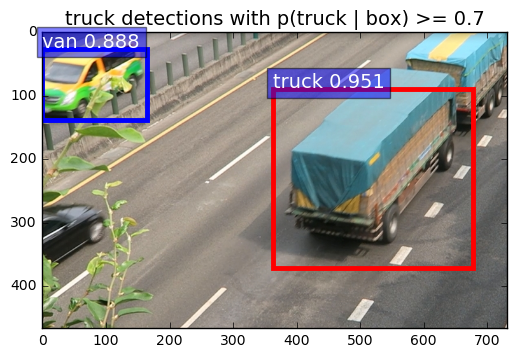

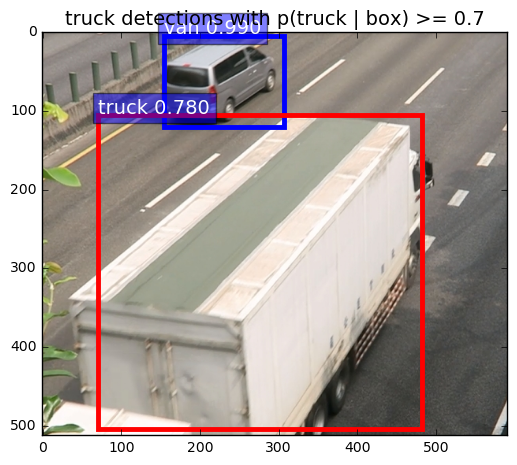

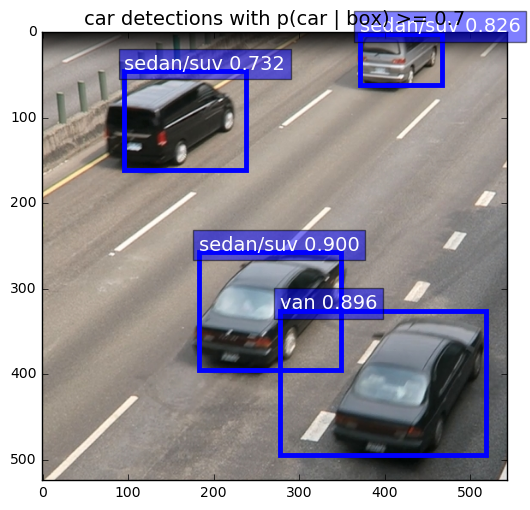

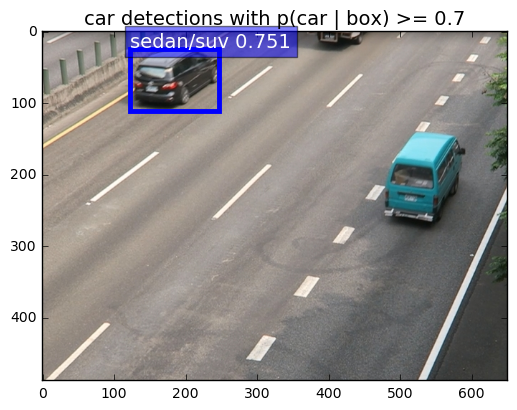

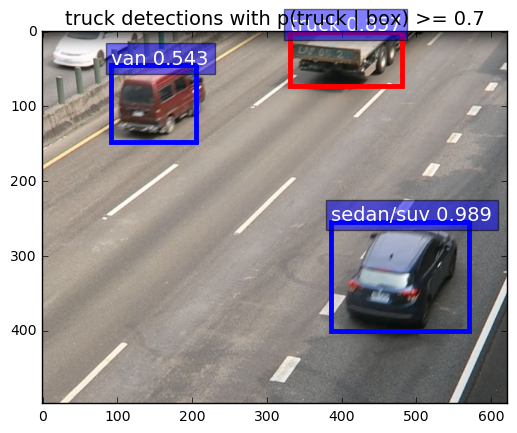

...

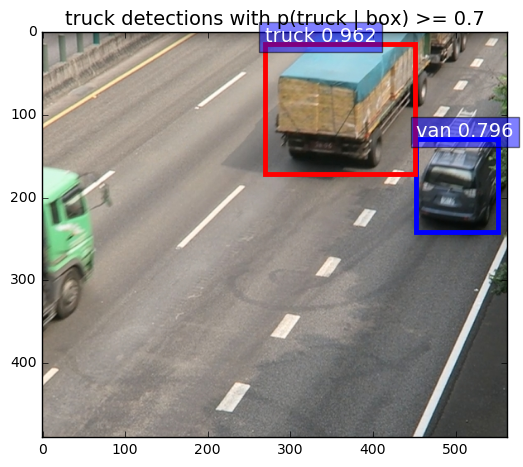

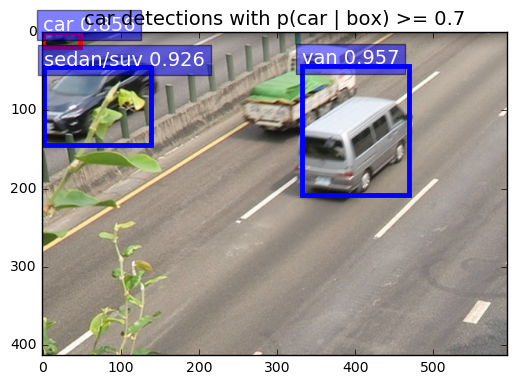

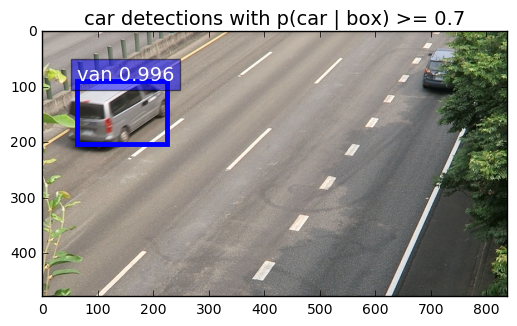

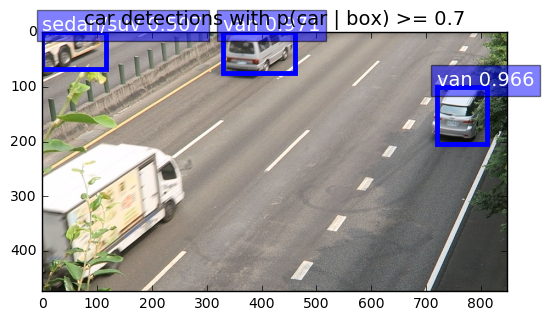

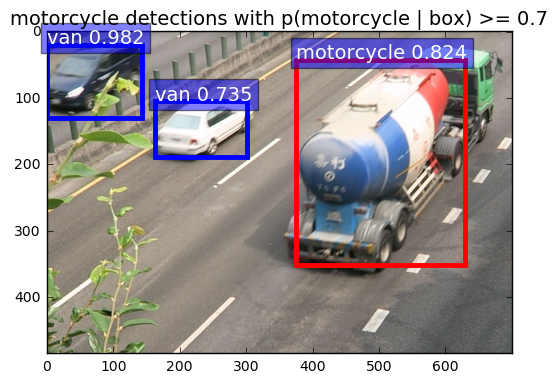

In [69]:
im_names = glob.glob("/root/data/Van/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_104410.jpg
(232, 301, 3)
Detection took 0.049s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/Ford_Truck_torro_terreno.jpg
(1224, 1632, 3)
Detection took 0.100s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_102350.jpg
(257, 432, 3)
Detection took 0.054s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_103903.jpg
(374, 522, 3)
Detection took 0.051s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/dd6f18b5d3cf1be2fd48c085584341f7--hotrods-dream-cars.jpg
(450, 600, 3)
Detection took 0.053s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~

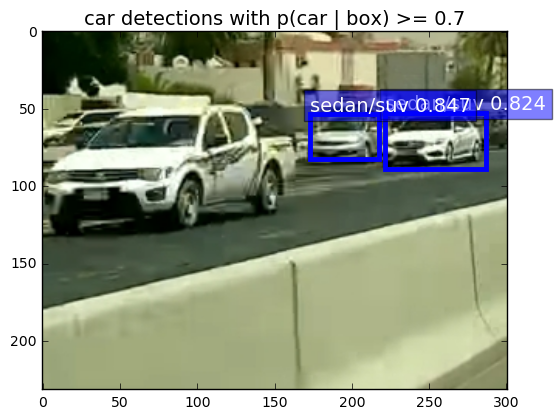

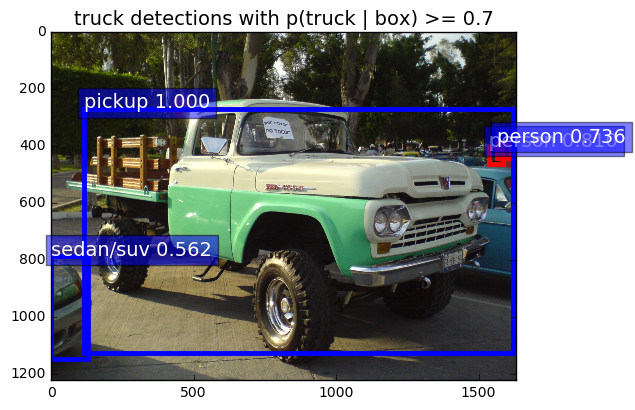

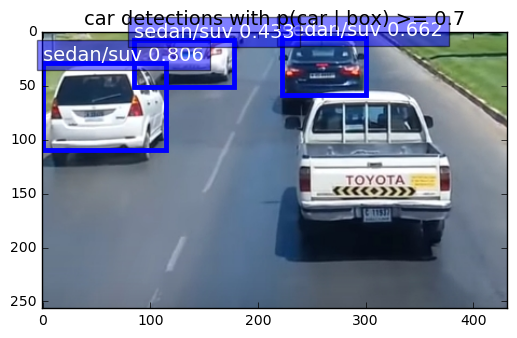

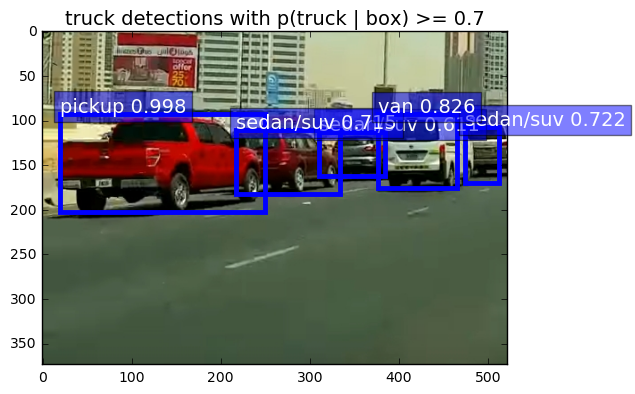

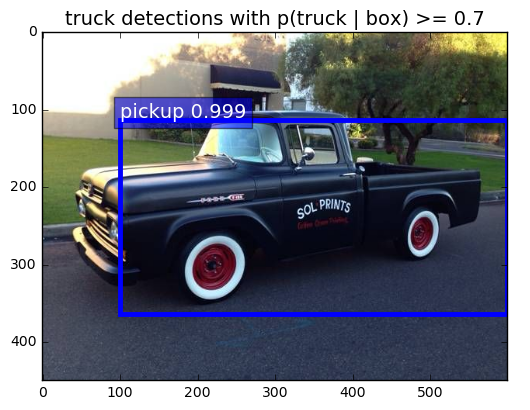

...

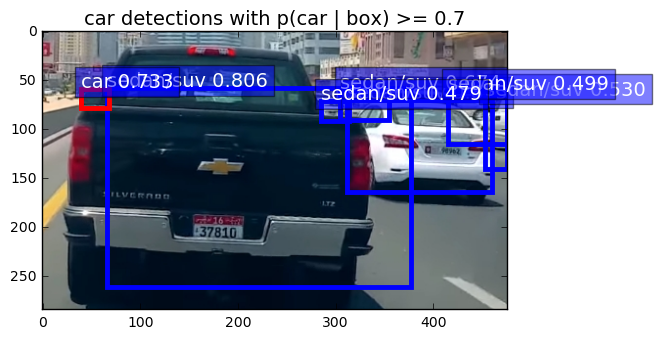

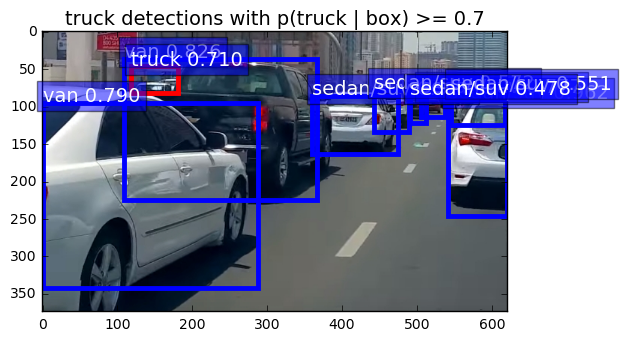

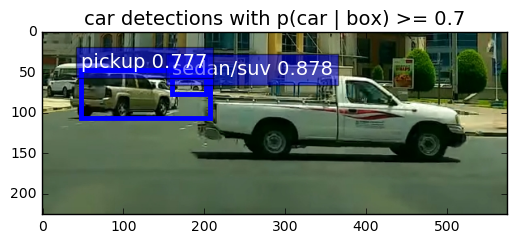

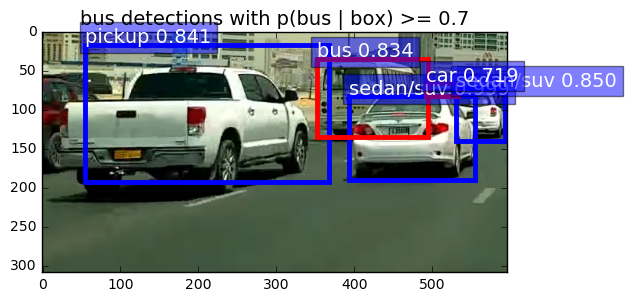

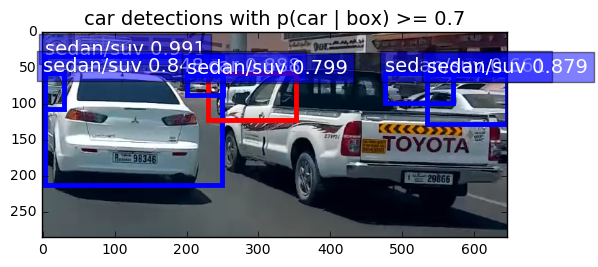

In [70]:
im_names = glob.glob("/root/data/demo/pickup_big/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S001.jpg
(539, 720, 3)
Detection took 0.063s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S026.jpg
(391, 640, 3)
Detection took 0.058s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S004.jpg
(360, 480, 3)
Detection took 0.053s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S010.jpg
(172, 293, 3)
Detection took 0.054s for 149 object proposals
(149, 324)
(149, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S002.jpg
(328, 500, 3)
Detection took 0.054s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S032.jpg
(387, 688, 3)
Detection took 0.060s for 200 object proposals
(200, 324)
(200, 81)
~~~~

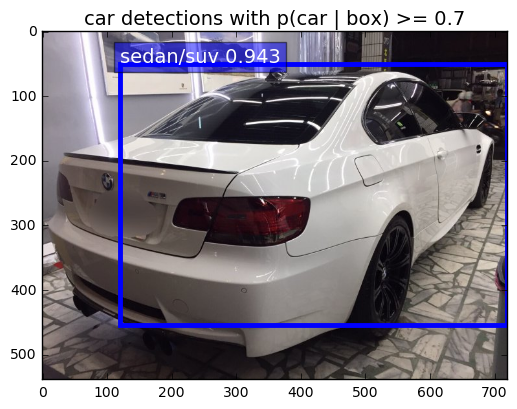

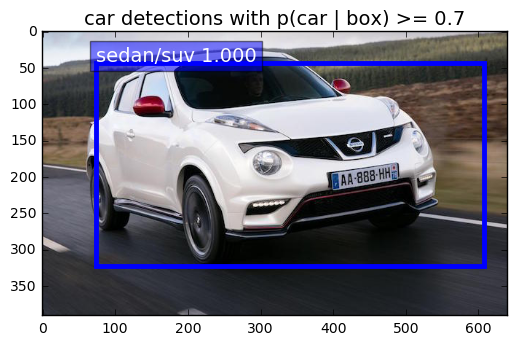

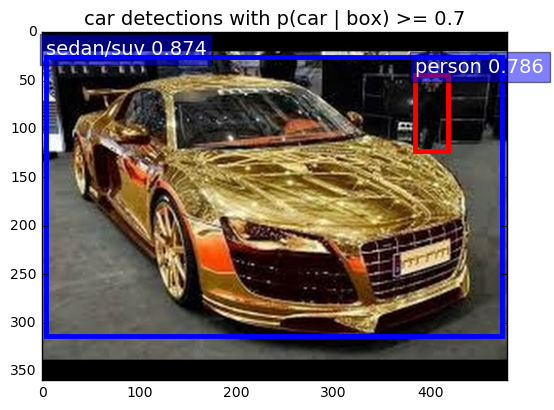

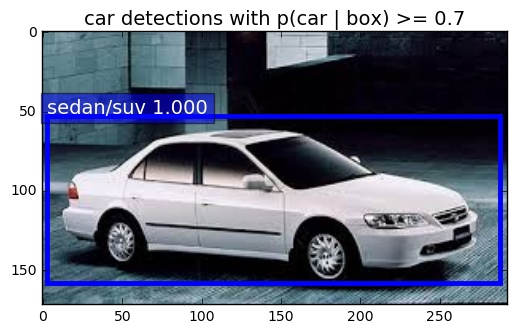

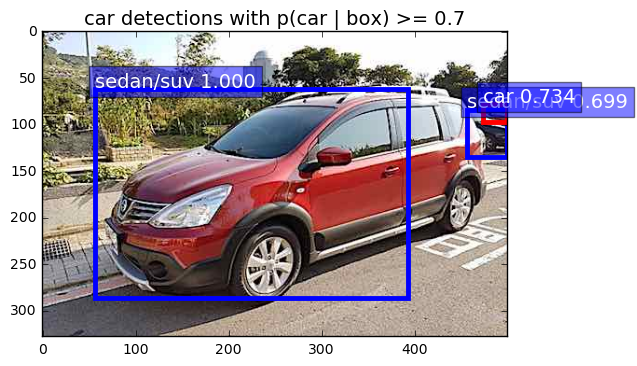

...

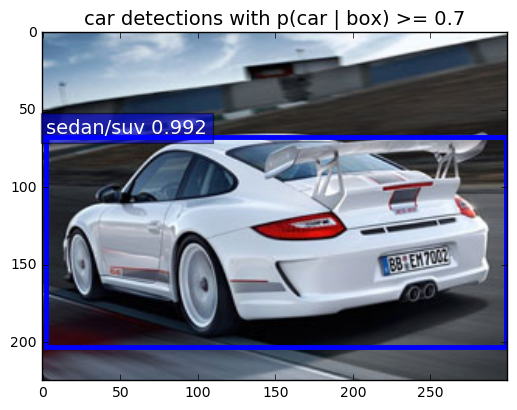

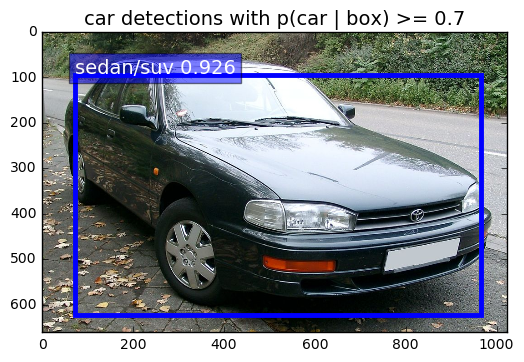

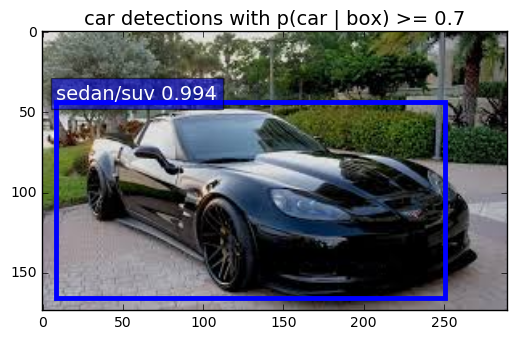

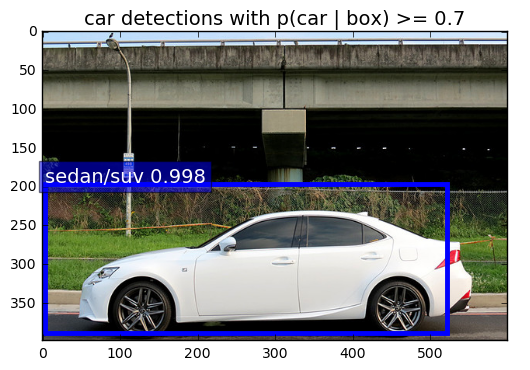

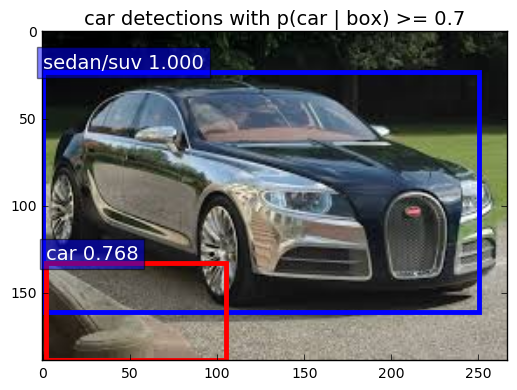

In [71]:
im_names = glob.glob("/root/data/demo/SUV/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_103513.jpg
(284, 712, 3)
Detection took 0.079s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_102821.jpg
(414, 947, 3)
Detection took 0.070s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_103559.jpg
(213, 643, 3)
Detection took 0.076s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/6280517930_b590ea5169_b.jpg
(769, 1024, 3)
Detection took 0.065s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_104511.jpg
(361, 557, 3)
Detection took 0.056s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big

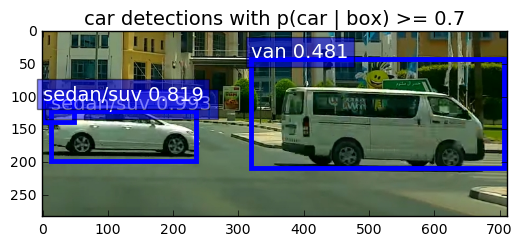

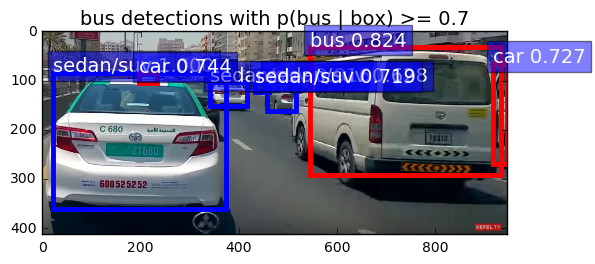

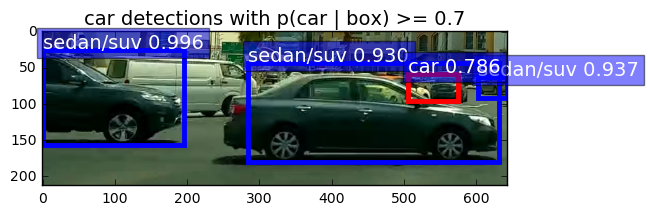

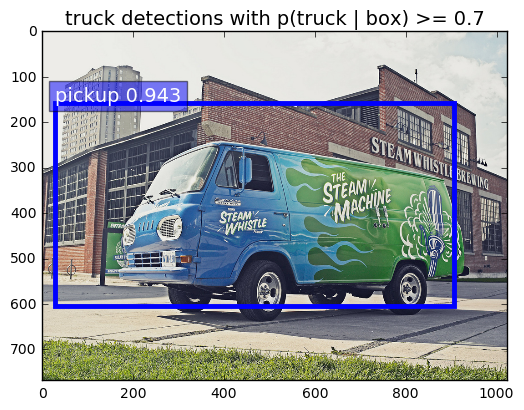

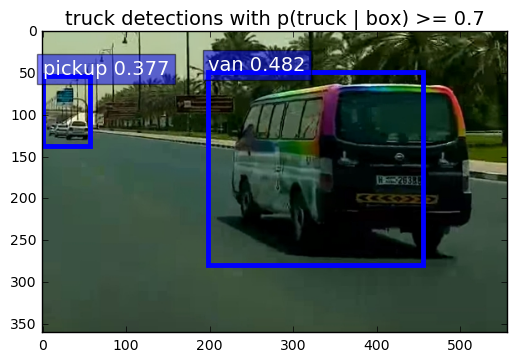

...

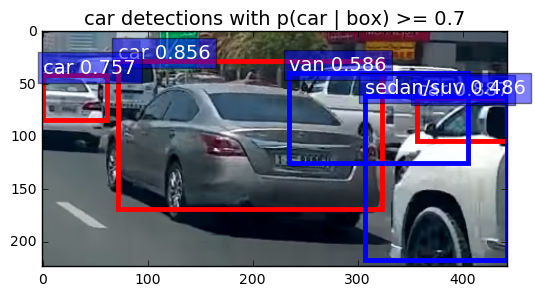

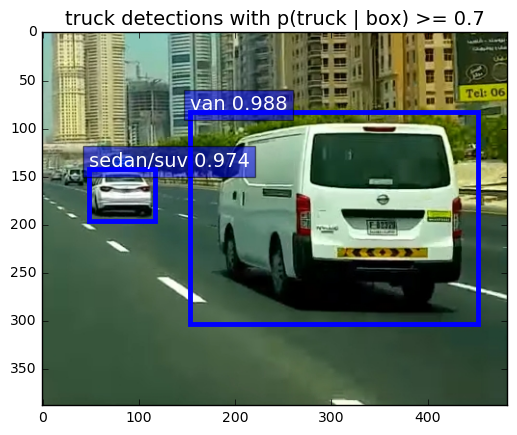

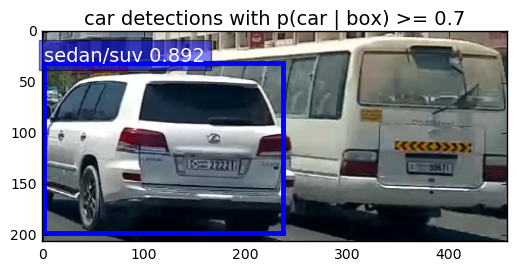

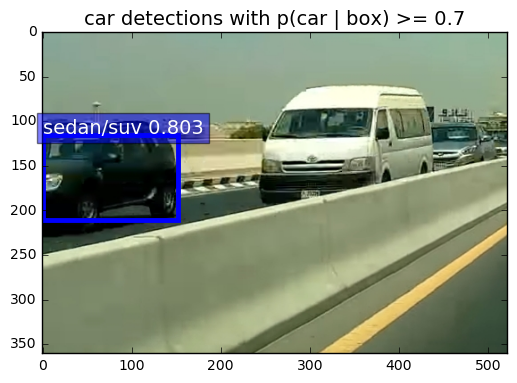

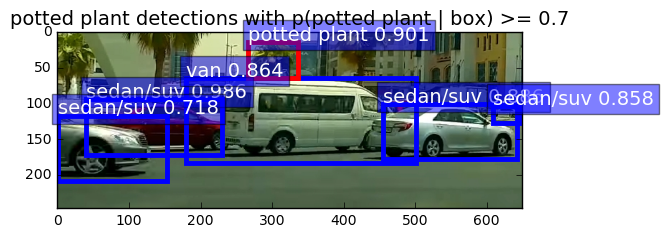

In [72]:
im_names = glob.glob("/root/data/demo/van_big/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_110921.jpg
(346, 534, 3)
Detection took 0.056s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_111236.jpg
(548, 632, 3)
Detection took 0.054s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/maxresdefault.jpg
(1080, 1920, 3)
Detection took 0.087s for 113 object proposals
(113, 324)
(113, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_110932.jpg
(396, 582, 3)
Detection took 0.054s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_111307.jpg
(273, 323, 3)
Detection took 0.051s for 200 object proposals
(200, 324)
(200, 81)
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/20

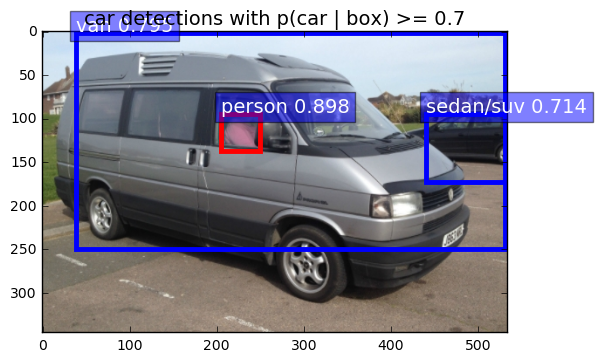

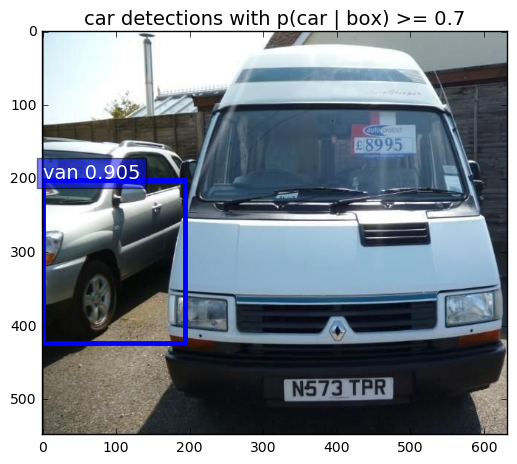

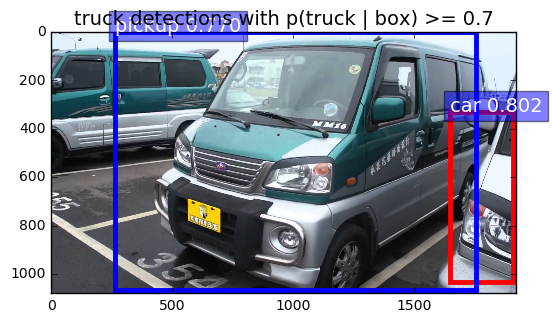

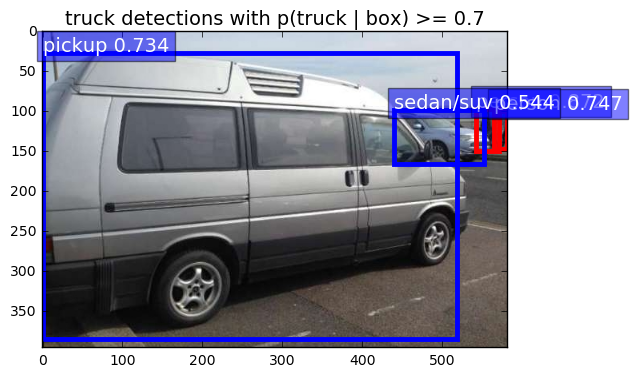

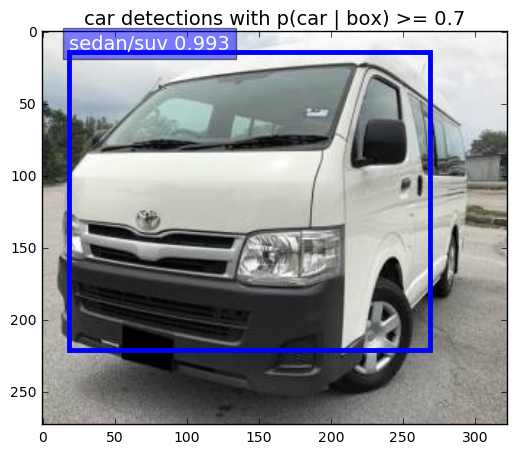

...

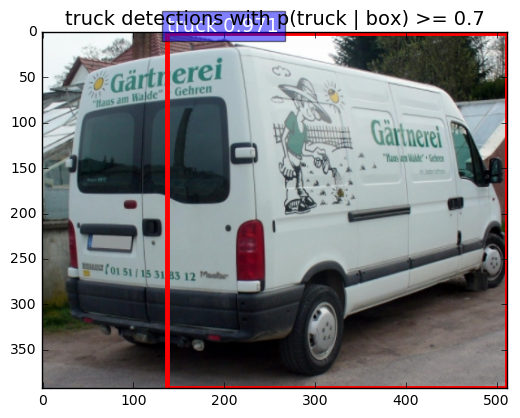

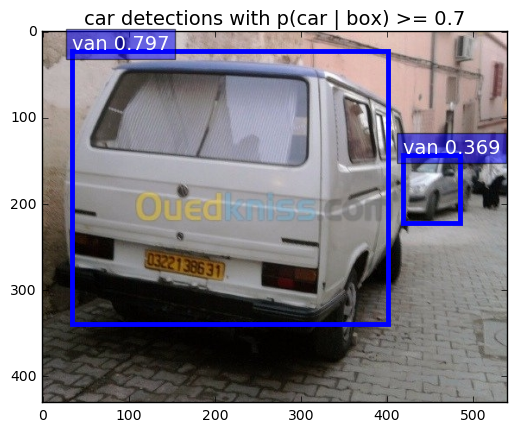

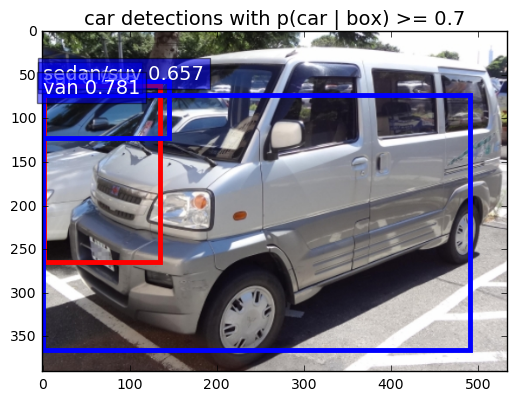

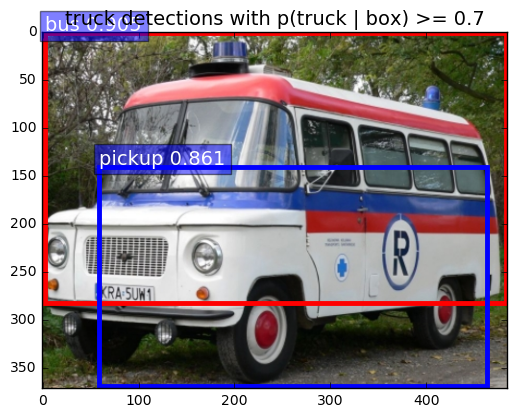

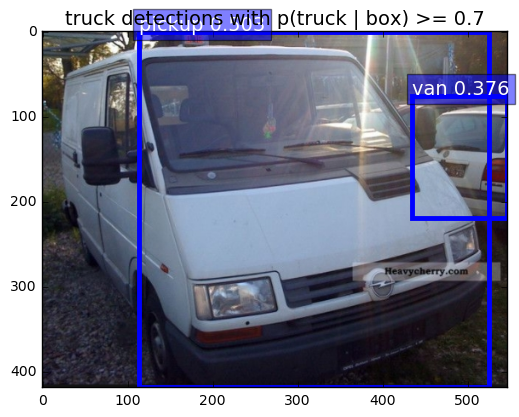

In [73]:
im_names = glob.glob("/root/data/demo/Van-1018/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/pva-faster-rcnn/tools/2017-10-26.jpg
(769, 1024, 3)
Detection took 0.082s for 200 object proposals
(200, 324)
(200, 81)


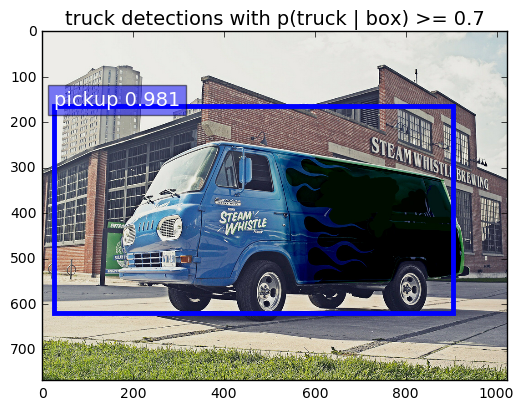

In [85]:
im_names = glob.glob("/root/pva-faster-rcnn/tools/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

In [82]:
!wget https://lh3.googleusercontent.com/-wCBB3dzYc-M/WfKR9Xi4M0I/AAAAAAAAAfg/lxdbpbRZrLgVL-Cd_ACsbrgVL9uZRtrGACL0BGAYYCw/h769/2017-10-26.jpg

--2017-10-27 02:18:13--  https://lh3.googleusercontent.com/-wCBB3dzYc-M/WfKR9Xi4M0I/AAAAAAAAAfg/lxdbpbRZrLgVL-Cd_ACsbrgVL9uZRtrGACL0BGAYYCw/h769/2017-10-26.jpg
Resolving lh3.googleusercontent.com (lh3.googleusercontent.com)... 172.217.24.1, 2404:6800:4008:800::2001
Connecting to lh3.googleusercontent.com (lh3.googleusercontent.com)|172.217.24.1|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 661846 (646K) [image/jpeg]
Saving to: '2017-10-26.jpg.2'

100%[======================================>] 661,846     --.-K/s   in 0.06s   

2017-10-27 02:18:13 (9.81 MB/s) - '2017-10-26.jpg.2' saved [661846/661846]



In [ ]:
imdb_group.bbox_status()